# Socio-Economic & Demographic Analysis of COVID-19 in USA

This analysis is part of our final project which uses data from several sources to analyze correlation between several social, economic and demographic factors related to COVID-19 pandemic in the USA.

1. ETL

Data from census.gov has been used. Data has been extracted and cleaned mostly using ETL in python.

2. Libraries

Several libraries, such as numpy, pandas, matplotlib and plotly have been used.  Ploty's geospatial tools have been used to show analysis output on a USA counties map.

In [1]:
# Import Libraries and dependencies
import numpy as np
from numpy import *
import pandas as pd
import matplotlib.pyplot as plt
%matplotlib inline

import plotly.figure_factory as ff
import seaborn as sns


In [2]:
# Retrieve and load covid data

covid = pd.read_csv("covid.csv")
covid = covid.rename(columns = {"Admin2" : "County"})
covid["FIPS"].fillna(999999999999, inplace = True)
covid["FIPS"] = list(map(int, covid["FIPS"]))

covid.head()

,FIPS,County,Province_State,Country_Region,Last_Update,Lat,Long_,Confirmed,Deaths,Recovered,Active,Combined_Key,Incidence_Rate,Case-Fatality_Ratio
0,45001,Abbeville,South Carolina,US,2020-06-08 03:33:22,34.223334,-82.461707,51,0,0,51,"Abbeville, South Carolina, US",207.934113,0.000000
1,22001,Acadia,Louisiana,US,2020-06-08 03:33:22,30.295065,-92.414197,502,28,0,474,"Acadia, Louisiana, US",809.090176,5.577689
2,51001,Accomack,Virginia,US,2020-06-08 03:33:22,37.767072,-75.632346,970,13,0,957,"Accomack, Virginia, US",3001.609110,1.340206
3,16001,Ada,Idaho,US,2020-06-08 03:33:22,43.452658,-116.241552,838,22,0,816,"Ada, Idaho, US",174.008019,2.625298
4,19001,Adair,Iowa,US,2020-06-08 03:33:22,41.330756,-94.471059,9,0,0,9,"Adair, Iowa, US",125.838926,0.000000


In [3]:
#Clean data from census.gov

def govdata(file, index):
    data = pd.read_csv(file)
    data.columns = data.iloc[index]
    data = data.drop([i for i in range(index + 1)], axis = 0)
    data.index -= index + 1
    data = data.rename(columns = {"FIPStxt" : "FIPS"})
    data["FIPS"] = list(map(int, data["FIPS"]))
    return data

In [4]:
#Retriev data files
unemployment = govdata("unemployment.csv", 6)
poverty = govdata("poverty.csv", 3)
population = govdata("population.csv", 1)
education = govdata("education.csv", 3)

unemployment.head()

6,FIPS,Stabr,area_name,Rural_urban_continuum_code_2013,Urban_influence_code_2013,Metro_2013,Civilian_labor_force_2000,Employed_2000,Unemployed_2000,Unemployment_rate_2000,...,Civilian_labor_force_2018,Employed_2018,Unemployed_2018,Unemployment_rate_2018,Civilian_labor_force_2019,Employed_2019,Unemployed_2019,Unemployment_rate_2019,Median_Household_Income_2018,Med_HH_Income_Percent_of_State_Total_2018
0,0,US,United States,NaN,NaN,NaN,"142,601,667","136,904,680","5,696,987",4.0,...,"161,389,026","155,102,319","6,286,707",3.9,"163,100,055","157,115,247","5,984,808",3.7,"61,937",NaN
1,1000,AL,Alabama,NaN,NaN,NaN,"2,133,223","2,035,594","97,629",4.6,...,"2,216,627","2,130,845","85,782",3.9,"2,241,747","2,174,483","67,264",3.0,"49,881",100.0
2,1001,AL,"Autauga County, AL",2,2,1,"21,720","20,846",874,4.0,...,"26,196","25,261",935,3.6,"26,172","25,458",714,2.7,"59,338",119.0
3,1003,AL,"Baldwin County, AL",3,2,1,"69,533","66,971","2,562",3.7,...,"95,233","91,809","3,424",3.6,"97,328","94,675","2,653",2.7,"57,588",115.5
4,1005,AL,"Barbour County, AL",6,6,0,"11,373","10,748",625,5.5,...,"8,414","7,987",427,5.1,"8,537","8,213",324,3.8,"34,382",68.9


In [5]:
# Retrieve race data
race = pd.read_csv("racial.csv")
race.head()

,State,FIPS,County,White,Black,Native,Asian,Hispanic
0,Alabama,1001,Autauga,76.725239,19.630942,0.480207,1.224798,2.965774
1,Alabama,1003,Baldwin,87.285228,8.940382,0.772399,1.150343,4.646779
2,Alabama,1005,Barbour,49.069571,48.398376,0.659137,0.454162,4.276355
3,Alabama,1007,Bibb,76.834821,21.294643,0.437500,0.236607,2.625000
4,Alabama,1009,Blount,95.878285,1.642462,0.653527,0.319848,9.571231


In [6]:
# List FIPS values 

fips_list = list(race["FIPS"])

#All lists to be created from data sources
county_list, state_list, confirmed_list, death_list, mortality_list = [], [], [], [], []
white, black, native, asian, hispanic = [], [], [], [], []
income_list, unemp_list, poverty_list, pop_list = [], [], [], []
less_high, highschool, somecollege, bachelor = [], [], [], []
confirmed_pop_list, death_pop_list = [], []

In [7]:
#Loops through all FIPS values
for fips in fips_list:
    
    #Finds rows from each data frame with current FIPS value
    covid_row = covid.loc[covid["FIPS"] == fips]
    unemp_row = unemployment.loc[unemployment["FIPS"] == fips]
    poverty_row = poverty.loc[poverty["FIPS"] == fips]
    pop_row = population.loc[population["FIPS"] == fips]
    education_row = education.loc[education["FIPS"] == fips]
    race_row = race.loc[race["FIPS"] == fips]

    #Case info from Johns Hopkins research
    county_list.append(list(covid_row["County"])[0]) 
    state_list.append(list(covid_row["Province_State"])[0]) 
    if list(covid_row["Confirmed"])[0] == 0:
        mortality_list.append(0)
    else:
        mortality_list.append(list((covid_row["Deaths"] / covid_row["Confirmed"]) * 100)[0])
    confirmed_list.append(int(list(covid_row["Confirmed"])[0]))
    death_list.append(int(list(covid_row["Deaths"])[0])) 


    confirmed_pop_list.append(list(covid_row["Confirmed"])[0] / float(list(pop_row["POP_ESTIMATE_2018"])[0].replace(",", "")) * 100000)
    death_pop_list.append(list(covid_row["Deaths"])[0] / float(list(pop_row["POP_ESTIMATE_2018"])[0].replace(",", "")) * 100000)

    #median household income and unemployment rate
    income_list.append(int(list(unemp_row["Median_Household_Income_2018"])[0].replace(",", "")))
    unemp_list.append(float(list(unemp_row["Unemployment_rate_2018"])[0]))

    #percent population under poverty line
    poverty_list.append(float(list(poverty_row["PCTPOVALL_2018"])[0]))
    
    #population
    pop_list.append(int(list(pop_row["POP_ESTIMATE_2018"])[0].replace(",", "")))
    
    #education
    less_high.append(float(list(education_row["Percent of adults with less than a high school diploma, 2014-18"])[0]))
    highschool.append(float(list(education_row["Percent of adults with a high school diploma only, 2014-18"])[0]))
    somecollege.append(float(list(education_row["Percent of adults completing some college or associate's degree, 2014-18"])[0]))
    bachelor.append(float(list(education_row["Percent of adults with a bachelor's degree or higher, 2014-18"])[0]))

    #Racial data 
    white.append(float(race_row["White"]))
    black.append(float(race_row["Black"]))
    native.append(float(race_row["Native"]))
    asian.append(float(race_row["Asian"]))
    hispanic.append(float(race_row["Hispanic"]))

In [8]:
#Create a new data frame from all of the lists

cleaned_data = pd.DataFrame({
                          "State" : state_list, "FIPS" : fips_list, "County" : county_list,
                          "Population 2018" : pop_list, "Median Household Income 2018 ($)" : income_list,
                          "Unemployment Rate 2018 (%)" : unemp_list, "Poverty Rate 2018 (%)" : poverty_list,
                          "Confirmed cases" : confirmed_list, "Confirmed Deaths" : death_list,
                          "Confirmed cases per 100K people" : confirmed_pop_list,
                          "Deaths per 100K people" : death_pop_list, "Mortality Rate (%)" : mortality_list,
                          "White (%)" : white, "Black (%)" : black,
                          "Native American (%)" : native, "Asian (%)" : asian,
                          "Hispanic (%)" : hispanic, "Dropout (%)" : less_high,
                          "High School Diploma (%)" : highschool, "Some College/Associate's Degree (%)" : somecollege,
                          "Bachelor's Degree or Higher (%)" : bachelor
                        })
cleaned_data.to_csv('data.csv')
cleaned_data.head(10)


,State,FIPS,County,Population 2018,Median Household Income 2018 ($),Unemployment Rate 2018 (%),Poverty Rate 2018 (%),Confirmed cases,Confirmed Deaths,Confirmed cases per 100K people,...,Mortality Rate (%),White (%),Black (%),Native American (%),Asian (%),Hispanic (%),Dropout (%),High School Diploma (%),Some College/Associate's Degree (%),Bachelor's Degree or Higher (%)
0,Alabama,1001,Autauga,55533,59338,3.6,13.8,265,5,477.193741,...,1.886792,76.725239,19.630942,0.480207,1.224798,2.965774,11.3,32.6,28.4,27.7
1,Alabama,1003,Baldwin,217855,57588,3.6,9.8,313,9,143.673544,...,2.875399,87.285228,8.940382,0.772399,1.150343,4.646779,9.7,27.6,31.3,31.3
2,Alabama,1005,Barbour,24872,34382,5.1,30.9,193,1,775.972982,...,0.518135,49.069571,48.398376,0.659137,0.454162,4.276355,27.0,35.7,25.1,12.2
3,Alabama,1007,Bibb,22367,46064,3.9,21.8,77,1,344.257165,...,1.298701,76.834821,21.294643,0.437500,0.236607,2.625000,16.8,47.3,24.4,11.5
4,Alabama,1009,Blount,57771,50412,3.5,13.2,72,1,124.630005,...,1.388889,95.878285,1.642462,0.653527,0.319848,9.571231,19.8,34.0,33.5,12.6
5,Alabama,1011,Bullock,10174,29267,4.6,42.5,232,7,2280.322390,...,3.017241,26.247781,70.704281,0.838430,0.187414,7.960150,24.8,39.7,22.3,13.3
6,Alabama,1013,Butler,19631,37365,4.7,24.5,449,22,2287.198818,...,4.899777,52.251016,44.913618,0.376016,1.316057,1.509146,15.4,43.9,24.6,16.1
7,Alabama,1015,Calhoun,114331,45400,4.6,19.5,176,3,153.939002,...,1.704545,75.278490,21.135487,0.539916,0.964324,3.910673,15.9,32.4,33.7,18.0
8,Alabama,1017,Chambers,33600,39917,3.8,18.7,378,26,1125.000000,...,6.878307,57.063811,40.000000,0.306411,1.326789,2.561357,18.6,38.4,29.7,13.2
9,Alabama,1019,Cherokee,26014,42132,3.5,16.3,42,4,161.451526,...,9.523810,93.027812,4.260141,0.660725,0.338045,1.621082,19.8,38.3,29.0,12.9


In [9]:
cleaned_data.describe()

,FIPS,Population 2018,Median Household Income 2018 ($),Unemployment Rate 2018 (%),Poverty Rate 2018 (%),Confirmed cases,Confirmed Deaths,Confirmed cases per 100K people,Deaths per 100K people,Mortality Rate (%),White (%),Black (%),Native American (%),Asian (%),Hispanic (%),Dropout (%),High School Diploma (%),Some College/Associate's Degree (%),Bachelor's Degree or Higher (%)
count,2959.000000,2.959000e+03,2959.000000,2959.000000,2959.000000,2959.000000,2959.000000,2959.000000,2959.000000,2959.000000,2959.000000,2959.000000,2959.000000,2959.000000,2959.000000,2959.000000,2959.000000,2959.000000,2959.000000
mean,30267.689084,1.076076e+05,52907.030416,4.138560,15.220953,646.709023,36.758364,372.359139,14.694736,3.465992,84.229755,9.784947,2.187493,1.571278,9.614081,13.531869,34.284589,30.560088,21.622237
std,15216.579589,3.355405e+05,14025.941509,1.442719,6.174689,4758.320786,431.391826,699.561070,37.744558,5.302961,16.255690,14.710205,7.267710,2.783350,13.748744,6.244929,7.212705,5.055190,9.545845
min,1001.000000,4.620000e+02,25385.000000,1.300000,2.600000,0.000000,0.000000,0.000000,0.000000,0.000000,5.325320,0.000000,0.000000,0.000000,0.610451,1.200000,5.500000,11.400000,5.400000
25%,18142.000000,1.269400e+04,43665.000000,3.200000,10.800000,13.000000,0.000000,73.109274,0.000000,0.000000,78.903678,0.935071,0.377409,0.474314,2.403604,8.850000,29.900000,27.200000,14.900000
50%,29111.000000,2.820400e+04,50587.000000,3.900000,14.200000,52.000000,1.000000,172.516546,3.337249,1.754386,90.911038,2.855236,0.615064,0.758277,4.430390,12.200000,34.600000,30.500000,19.200000
75%,45058.000000,7.313150e+04,59011.500000,4.800000,18.400000,226.500000,8.000000,400.250882,14.105873,5.225722,95.414974,11.683090,1.269921,1.478203,9.998449,17.400000,39.300000,34.000000,25.800000
max,56045.000000,1.007391e+07,140382.000000,18.900000,54.000000,206969.000000,21844.000000,12704.850358,1340.900092,100.000000,99.043785,86.069762,92.515200,42.952310,96.359551,48.500000,55.600000,48.000000,78.500000


In [10]:
#Min-Max normalizes/scales any list
def normalize(input_data):
    return ((np.array(input_data) - min(input_data)) / (max(input_data) - min(input_data)))

3. Data Analysis

Data Analysis is conducted on the new data frame and correlation is shown betwen different variables by graphs and maps.

In [11]:
#Create a chloropleth map based USA counties' map template 
def plotMap(input_data):
    end_points = list(np.percentile(input_data, [5 + (5 * i) for i in range(19)])) 
    i = 0
    while i < len(end_points):
        if end_points.count(end_points[i]) > 1 or end_points[i] == min(input_data) or end_points[i] == max(input_data):
            del end_points[i]
        else:
            i += 1
            
    colorScale, numColors = [], len(end_points) + 1
    for i in range(numColors): 
        colorScale.append("rgb(" + str(200 - ((100 / (numColors - 1)) * i)) + ", " + str(251 - ((203 / (numColors - 1)) * i)) + ", " + str(255 - ((148 / (numColors - 1)) * i)) + ")")
        
    fig = ff.create_choropleth(fips = fips_list, values = input_data, colorscale = colorScale, binning_endpoints = end_points)
    fig.layout.template = None 

    title='USA COVID Mortality Rate %'
    legend_title='COVID Mortality Rate %'
    fig.show() 

In [12]:
#Plot shows COVID-19 mortality rate by county
plotMap(mortality_list)

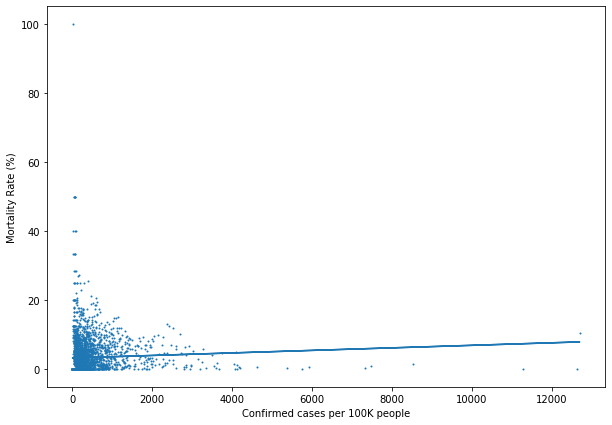

Correlation coefficient: 0.048235229425364984


In [13]:
#Create a linear regression line 
def regLine(x, y):
    coeff = np.polyfit(x, y, 1)
    return [((coeff[0] * x[i]) + coeff[1]) for i in range(len(x))]

#correlation coefficient 
def coeff(x, y):
    return np.corrcoef(x, y)[0][1]


#Plotting the confirmed cases per 100k people against mortality rate
plt.rcParams["figure.figsize"] = (10, 7)

plt.xlabel("Confirmed cases per 100K people")
plt.ylabel("Mortality Rate (%)")
plt.scatter(confirmed_pop_list, mortality_list, 1)
plt.plot(confirmed_pop_list, regLine(confirmed_pop_list, mortality_list))
plt.savefig("Images/pop_vs_mort.png")
plt.show()

print("Correlation coefficient: " + str(coeff(confirmed_pop_list, mortality_list)))

In [13]:
#Plot shows confirmed cases per 100K people by county
plotMap(confirmed_pop_list)

The mortality map shows a general pattern of 4 clusters whre the proportion of people that have contracted COVID-19 and who died:
    
1. North_East
2. South_East
3. Midwest
4. South_West 

This analysis can also stipulate that these counties' healthcare system are most likely overwhelmed by COVID-19 patients and the high number of deaths means that some patients cannot get the healthcare they require.

Although the coefficient of correlation is positie, it is very weak.

In [14]:
#Plot shows deaths per 100K people by county
plotMap(death_pop_list)

The deaths per 100K people map coincides almost perfectly with the confirmed cases per 100K people, but this makes sense because the higher the number of confirmed cases, the higher number of deaths as well.

The below analysis compare non-pandemic factors with COVID-19 deaths per 100K people.

A. Economic Factors
This section focuses on economic health and stability such as median household income, poverty and unemployment.

In [15]:
#Plot shows poverty rate by county
plotMap(poverty_list)

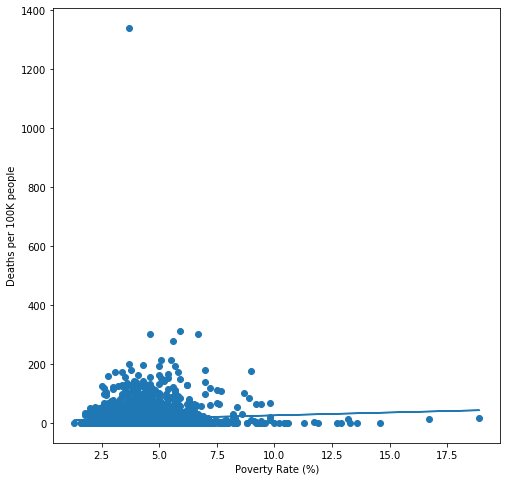

Correlation coefficient: 0.07417956502194578


In [18]:
#plot to show correlation of Poverty rate against deaths per 100K people
plt.rcParams["figure.figsize"] = (8, 8)

x, y = (unemp_list), (death_pop_list)
plt.xlabel("Poverty Rate (%)")
plt.ylabel("Deaths per 100K people")
plt.scatter(x, y)
plt.plot(x, regLine(x, y))
plt.savefig("Images/pov_vs_death_100K.png")
plt.show()

print("Correlation coefficient: " + str(coeff(x, y)))

The graphs above show that there is positive correlation between poverty and deaths per 100K people.  Because the relation is weak, the poverty level can be explained by the fact that people in poor counties can't afford healthcare or they can't afford to stay at home, as such, they are more exposed to the virus when they are at work.

In [17]:
#Plot shows unemployment rate by county
plotMap(unemp_list)


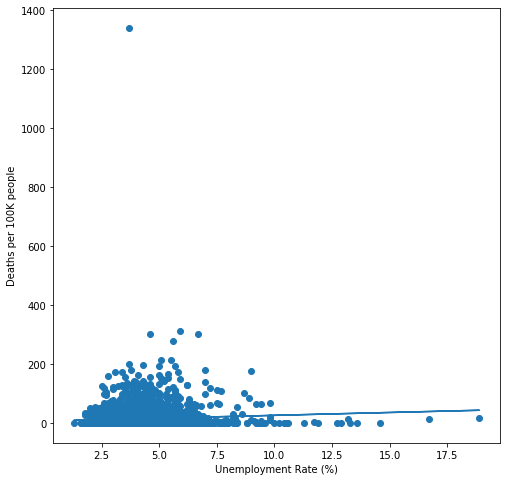

Correlation coefficient: 0.07417956502194578


In [19]:
#plot to show correlation of unemployment rate against deaths per 100K people
plt.rcParams["figure.figsize"] = (8, 8)

x, y = (unemp_list), (death_pop_list)
plt.xlabel("Unemployment Rate (%)")
plt.ylabel("Deaths per 100K people")
plt.scatter(x, y)
plt.plot(x, regLine(x, y))
plt.savefig("Images/unemp_vs_death_100K")
plt.show()

print("Correlation coefficient: " + str(coeff(x, y)))

Based on the unemployment map above, there are three geographical regions from the deaths per 100K people map that coincide with this one - the South-West, the South-East, and the Midwest.

The South has both high poverty rate and high unemployment rate; the same goes for the South-West. 
    


In [20]:
#Plot shows median household income by county
plotMap(income_list)

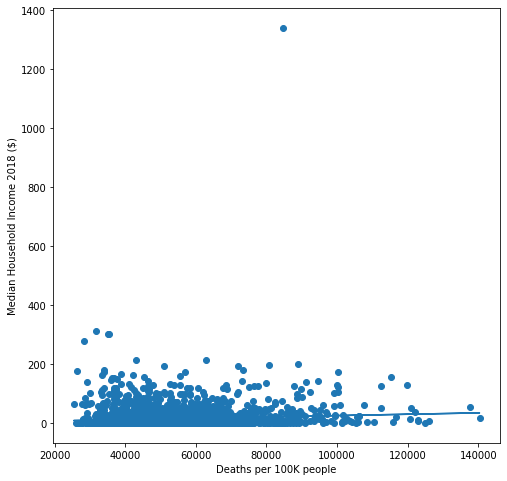

Correlation coefficient: 0.08368246542997705


In [21]:
#Show correlation of median household income with deaths per 100K people
plt.rcParams["figure.figsize"] = (8, 8)

x, y = (income_list), (death_pop_list)
plt.xlabel("Deaths per 100K people")
plt.ylabel("Median Household Income 2018 ($)")
plt.scatter(x, y)
plt.plot(x, regLine(x, y))
plt.savefig("Images/Income_vs_death_100K")
plt.show()

print("Correlation coefficient: " + str(coeff(x, y)))

There is a positive correlation between median income and deaths per 100k people.  The map shows that midwest and northeast have higher median income, however, the death per 100k people map also shows these areas to have higher deaths.
I believe it might be due to higher population density in these regions.

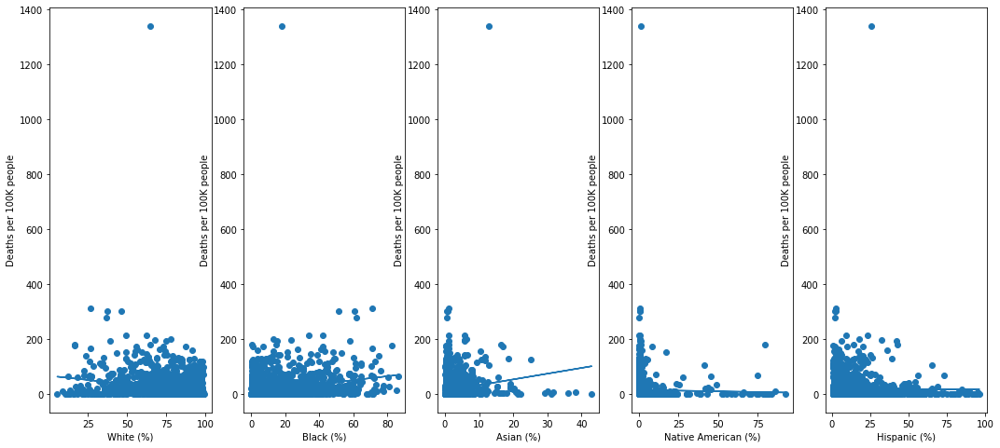

Correlation coefficient of White: -0.2652917070983538
Correlation coefficient of Black: 0.2781417917641285
Correlation coefficient of Native American: -0.01982274829419273
Correlation coefficient of Asian: 0.15416981919172412
Correlation coefficient of Hispanic: 0.012694766890751944


In [22]:
#Plot correlation of races with deaths per 100K people
plt.rcParams["figure.figsize"] = (18, 8)

plt.subplot(1, 5, 1)
plt.xlabel("White (%)")
plt.ylabel("Deaths per 100K people")
plt.scatter(white, death_pop_list)
plt.plot(white, regLine(white, death_pop_list))

# show for Black
plt.subplot(1, 5, 2)
plt.xlabel("Black (%)")
plt.ylabel("Deaths per 100K people")
plt.scatter(black, death_pop_list)
plt.plot(black, regLine(black, death_pop_list))


plt.subplot(1, 5, 3)
plt.xlabel("Asian (%)")
plt.ylabel("Deaths per 100K people")
plt.scatter(asian, death_pop_list)
plt.plot(asian, regLine(asian, death_pop_list))


plt.subplot(1, 5, 4)
plt.xlabel("Native American (%)")
plt.ylabel("Deaths per 100K people")
plt.scatter(native, death_pop_list)
plt.plot(native, regLine(native, death_pop_list))


plt.subplot(1, 5, 5)
plt.xlabel("Hispanic (%)")
plt.ylabel("Deaths per 100K people")
plt.scatter(hispanic, death_pop_list)
plt.plot(hispanic, regLine(hispanic, death_pop_list))

plt.savefig("Images/race_vs_death_100K.png")
plt.show()

print("Correlation coefficient of White: " + str(coeff(white, death_pop_list)))
print("Correlation coefficient of Black: " + str(coeff(black, death_pop_list)))
print("Correlation coefficient of Native American: " + str(coeff(native, death_pop_list)))
print("Correlation coefficient of Asian: " + str(coeff(asian, death_pop_list)))
print("Correlation coefficient of Hispanic: " + str(coeff(hispanic, death_pop_list)))





The racial analysis focuses on the racial makeup of a county's population.

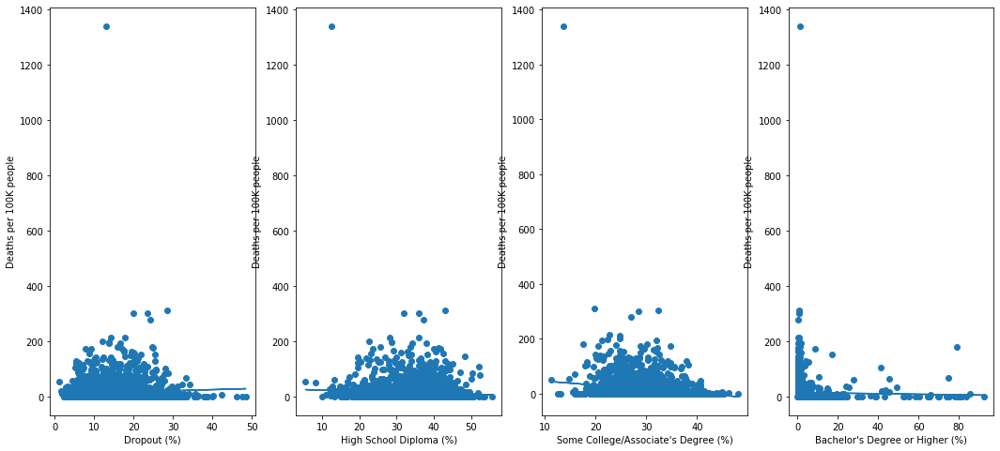

Correlation coefficient of Dropout: 0.06653406943497597
Correlation coefficient of Highschool Diploma: -0.0703241008052317
Correlation coefficient of Some College/Associate's Degree: -0.20037472404276685
Correlation coefficient of Bachelor's Degree: 0.11567252928608573


In [23]:
#Plot correlation of education with deaths per 100K people
plt.rcParams["figure.figsize"] = (18, 8)

plt.subplot(1, 4, 1)
plt.xlabel("Dropout (%)")
plt.ylabel("Deaths per 100K people")
plt.scatter(less_high, death_pop_list)
plt.plot(less_high, regLine(less_high, death_pop_list))


plt.subplot(1, 4, 2)
plt.xlabel("High School Diploma (%)")
plt.ylabel("Deaths per 100K people")
plt.scatter(highschool, death_pop_list)
plt.plot(highschool, regLine(highschool, death_pop_list))


plt.subplot(1, 4, 3)
plt.xlabel("Some College/Associate's Degree (%)")
plt.ylabel("Deaths per 100K people")
plt.scatter(somecollege, death_pop_list)
plt.plot(somecollege, regLine(somecollege, death_pop_list))


plt.subplot(1, 4, 4)
plt.xlabel("Bachelor's Degree or Higher (%)")
plt.ylabel("Deaths per 100K people")
plt.scatter(native, death_pop_list)
plt.plot(native, regLine(native, death_pop_list))

plt.savefig("Images/edu_vs_death_per_100K.png")
plt.show()

print("Correlation coefficient of Dropout: " + str(coeff(less_high, death_pop_list)))
print("Correlation coefficient of Highschool Diploma: " + str(coeff(highschool, death_pop_list)))
print("Correlation coefficient of Some College/Associate's Degree: " + str(coeff(somecollege, death_pop_list)))
print("Correlation coefficient of Bachelor's Degree: " + str(coeff(bachelor, death_pop_list)))





The educational analysis focuses on different types of educational backgrounds in a population.

The analysis below shows correlation between different socio-economic factors without considering COVID-19 data.

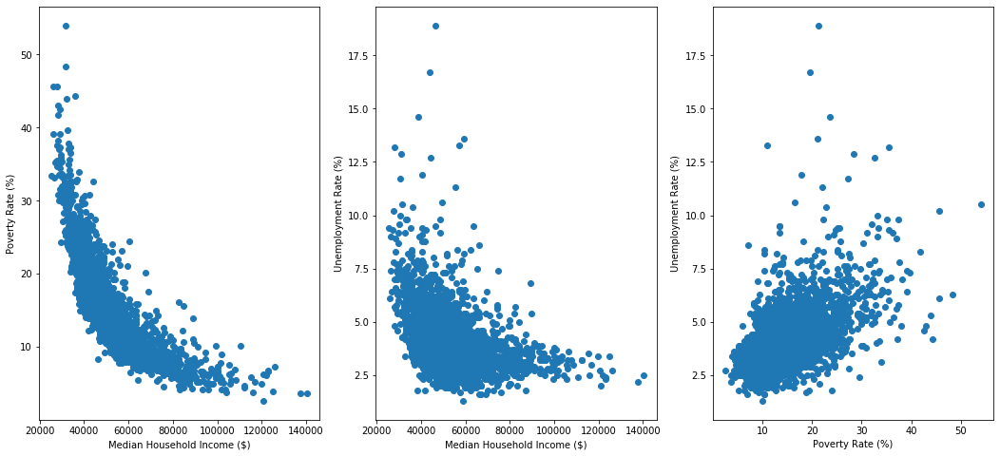

In [24]:
#Plotting relationships between economic factors
plt.rcParams["figure.figsize"] = (18, 8)

plt.subplot(1, 3, 1)
plt.xlabel("Median Household Income ($)")
plt.ylabel("Poverty Rate (%)")
plt.scatter(income_list, poverty_list)

plt.subplot(1, 3, 2)
plt.xlabel("Median Household Income ($)")
plt.ylabel("Unemployment Rate (%)")
plt.scatter(income_list, unemp_list)

plt.subplot(1, 3, 3)
plt.xlabel("Poverty Rate (%)")
plt.ylabel("Unemployment Rate (%)")
plt.scatter(poverty_list, unemp_list)
plt.savefig("Images/socio_economic.png")
plt.show()

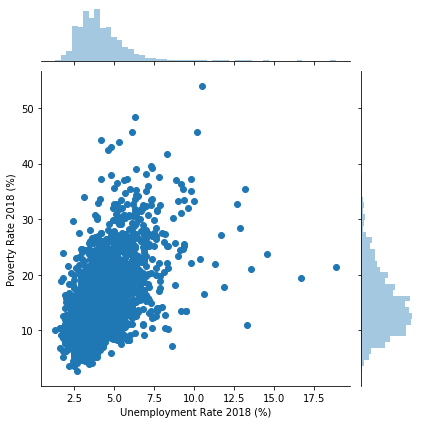

In [25]:
sns.jointplot(x='Unemployment Rate 2018 (%)',y='Poverty Rate 2018 (%)',data = cleaned_data)
plt.savefig("Images/unemp_pov.png")


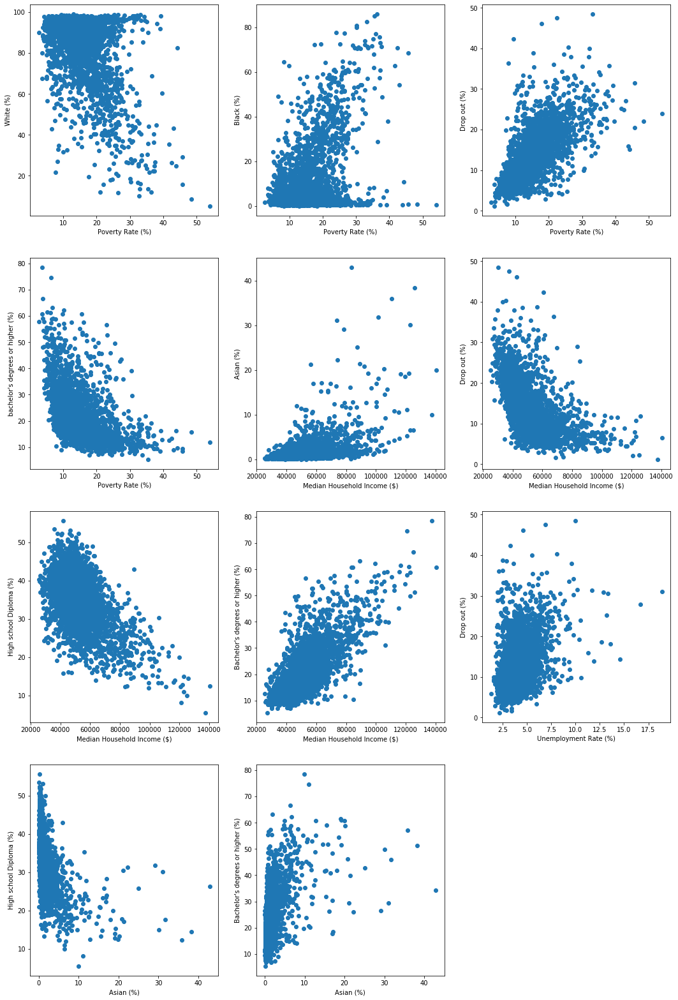

In [26]:
#Plotting other relationships (only significant ones plotted)

plt.rcParams["figure.figsize"] = (18, 28)

plt.subplot(4, 3, 1)
plt.xlabel("Poverty Rate (%)")
plt.ylabel("White (%)")
plt.scatter(poverty_list, white)

plt.subplot(4, 3, 2)
plt.xlabel("Poverty Rate (%)")
plt.ylabel("Black (%)")
plt.scatter(poverty_list, black)

plt.subplot(4, 3, 3)
plt.xlabel("Poverty Rate (%)")
plt.ylabel("Drop out (%)")
plt.scatter(poverty_list, less_high)

plt.subplot(4, 3, 4)
plt.xlabel("Poverty Rate (%)")
plt.ylabel("bachelor's degrees or higher (%)")
plt.scatter(poverty_list, bachelor)

plt.subplot(4, 3, 5)
plt.xlabel("Median Household Income ($)")
plt.ylabel("Asian (%)")
plt.scatter(income_list, asian)

plt.subplot(4, 3, 6)
plt.xlabel("Median Household Income ($)")
plt.ylabel("Drop out (%)")
plt.scatter(income_list, less_high)

plt.subplot(4, 3, 7)
plt.xlabel("Median Household Income ($)")
plt.ylabel("High school Diploma (%)")
plt.scatter(income_list, highschool)

plt.subplot(4, 3, 8)
plt.xlabel("Median Household Income ($)")
plt.ylabel("Bachelor's degrees or higher (%)")
plt.scatter(income_list, bachelor)

plt.subplot(4, 3, 9)
plt.xlabel("Unemployment Rate (%)")
plt.ylabel("Drop out (%)")
plt.scatter(unemp_list, less_high)

plt.subplot(4, 3, 10)
plt.xlabel("Asian (%)")
plt.ylabel("High school Diploma (%)")
plt.scatter(asian, highschool)

plt.subplot(4, 3, 11)
plt.xlabel("Asian (%)")
plt.ylabel("Bachelor's degrees or higher (%)")
plt.scatter(asian, bachelor)
plt.savefig("Images/other_rel.png")
plt.show()

Final Analysis combines all the socio_economic factors and correlates it with the deaths per 100K people to show the big picture.


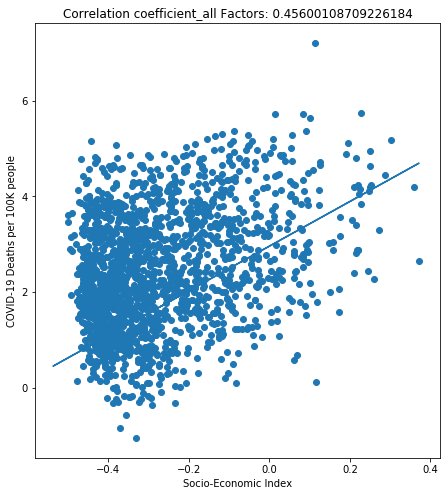

In [28]:
#Plotting combined of all factors against deaths per 100K people
plt.rcParams["figure.figsize"] = (16, 8)

lists = [poverty_list, unemp_list, income_list, white, black, hispanic, asian, native, less_high, highschool, somecollege, bachelor]
coeffs = []


y = ma.log(death_pop_list)
coeffs.clear()
for i in range(len(lists)):
    coeffs.append(coeff(normalize(lists[i]), y))

index = np.array([0 for i in range(len(y))])
for i in range(len(lists)):
    index = index + (coeffs[i] * normalize(lists[i]))

plt.subplot(1, 2, 2)
plt.xlabel("Socio-Economic Index")
plt.ylabel("COVID-19 Deaths per 100K people")
plt.title("Correlation coefficient_all Factors: " + str(coeff(index, y)))
plt.scatter(index, y)
plt.plot(index, regLine(index, y))

plt.savefig("Images/all.png")
plt.show()



It’s not just one factor that matters.
As can be seen from the final analysis, the combination of all factors weighted according to their correlation coefficient yielded a much stronger correlation than any of the individual analyses. In general, there are two types of counties which are affected negatively more than others.

Counties with very high populations and population densities such as those in the Midwest. People in these counties are easily exposed to the virus and transmission occurs much quicker, often leading to overwhelmed hospitals and tired doctors.

Counties with high poverty/unemployment and low median incomes also tend to have higher proportions of Native Americans and African Americans such as those in the South-East and the reservations in the South-West. In addition, the lack of affordable quality healthcare also means that people don’t get adequate medical attention.



Sources -
https://github.com/CSSEGISandData/COVID-19

https://www.ers.usda.gov/data-products/county-level-data-sets/download-data/

https://www.census.gov/data/tables/time-series/demo/popest/2010s-counties-detail.html

